# Modeling Cross Section Data with XGB

In [11]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import os
from joblib import dump, load

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 50)
pd.options.mode.chained_assignment = None  # default='warn'

In [12]:
import sys
# This allows us to import the nucml utilities
sys.path.append("../..")

import nucml.exfor.data_utilities as exfor_utils # pylint: disable=import-error
import nucml.exfor.plot as exfor_plot_utils # pylint: disable=import-error
import nucml.plot.utilities as plot_utils # pylint: disable=import-error
import nucml.datasets as nuc_data # pylint: disable=import-error
import nucml.ace.data_utilities as ace_utils # pylint: disable=import-error
import nucml.model.utilities as model_utils # pylint: disable=import-error
import nucml.model.plot as model_plots
import nucml.model.building_utils as build_utils

In [13]:
importlib.reload(exfor_utils)
importlib.reload(exfor_plot_utils)
importlib.reload(plot_utils)
importlib.reload(nuc_data)
importlib.reload(ace_utils)
importlib.reload(model_utils)
importlib.reload(model_plots)
print("Finish re-loading scripts.")

Finish re-loading scripts.


In [14]:
figure_dir = "../Figures/"

# Loading Dataset

In [15]:
df, x_train, x_test, y_train, y_test = nuc_data.load_exfor(normalize=False, pedro_v2=True, basic=0)

INFO:root: MODE: neutrons
INFO:root: LOW ENERGY: True
INFO:root: LOG: True
INFO:root: BASIC: 0
INFO:root:Reading data from C:/Users/Pedro/Desktop/ML_Nuclear_Data/EXFOR/CSV_Files\EXFOR_neutrons\EXFOR_neutrons_MF3_AME_no_RawNaN.csv
INFO:root:Data read into dataframe with shape: (4184115, 8)
INFO:root:Splitting dataset into training and testing...


# XGBoost

In [34]:
import xgboost as xgb

In [35]:
dtrain = xgb.DMatrix(x_train.values, y_train.values)
dtest = xgb.DMatrix(x_test.values, y_test.values)

evallist = [(dtrain, 'train'), (dtest, 'eval')]

In [39]:
# get max_depth to 0, change grow policy to lossguide, increase max bin, increase num_parallel_tree
num_round = 10 # number of gradient boosted trees
progress_v2 = dict()

In [40]:
param = build_utils.get_xgboost_params(eta=0.8, max_depth=5, max_bin=30000, gpu_id=1)

In [32]:
bst = xgb.train(param, dtrain, num_round, evallist, 
                evals_result=progress_v2, verbose_eval=False, 
                early_stopping_rounds=10)

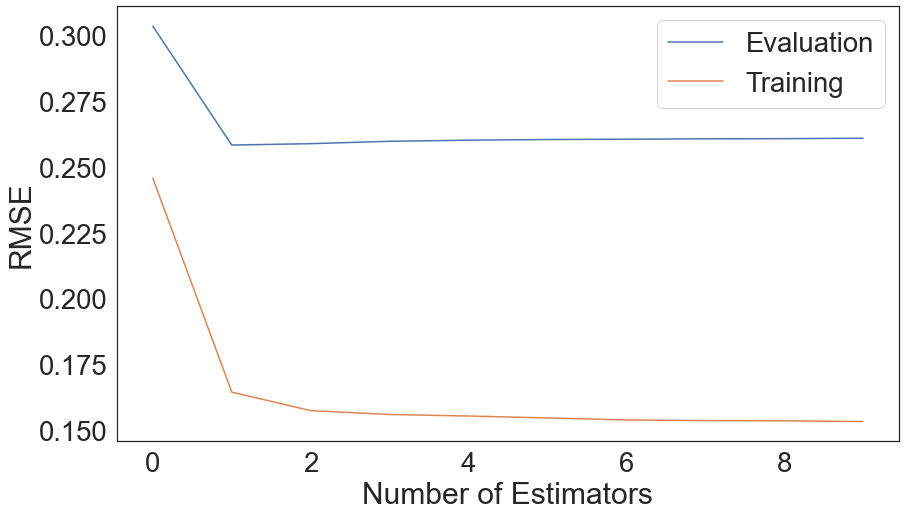

In [216]:
model_plots.xgb_training(progress_v2, save=False, save_dir=os.path.join(figure_dir, "xgb_training_plot.svg"))

In [69]:
train_iteration_metrics = pd.DataFrame(progress_v2['train'])
test_iteration_metrics = pd.DataFrame(progress_v2['eval'])
train_iteration_metrics.columns = [x + "_train" for x in train_iteration_metrics.columns]
test_iteration_metrics.columns = [x + "_test" for x in test_iteration_metrics.columns]

In [70]:
all_iteration_metrics = pd.merge(train_iteration_metrics, test_iteration_metrics, left_index=True, right_index=True)

,rmse_train,mae_train,rmse_test,mae_test
0,0.594110,0.361430,0.593680,0.362038
1,0.534251,0.328545,0.534551,0.329240
2,0.523655,0.324351,0.524280,0.325125
3,0.484228,0.304520,0.484793,0.305283
4,0.475629,0.300666,0.476155,0.301169
5,0.469237,0.297045,0.469885,0.297558
6,0.461732,0.293402,0.462281,0.293821
7,0.452890,0.288693,0.453786,0.289218
8,0.444617,0.283645,0.445563,0.284184
9,0.441623,0.281329,0.442525,0.281790


In [50]:
cl_b1 = exfor_utils.predicting_nuclear_xs_v2_no_norm(
    df, 17, 35, 103, bst, show=True, save=False, model_type="xgb",
    path="Figures/KNN/B1_cl35_np.png", get_endf=True, log=True, save_both=True)

INFO:root:EVALUATION: Extracting data from C:/Users/Pedro/Desktop/ML_Nuclear_Data/Evaluated_Data\neutrons/Cl035/endfb8.0/tables/xs/n-Cl035-MT103.endfb8.0
INFO:root:EVALUATION: Converting MeV to eV...
INFO:root:EVALUATION: Converting mb to b...
INFO:root:EVALUATION: Finished. ENDF data contains 8791 datapoints.
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (215, 40)
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (215, 40)


In [115]:
c_b1 = exfor_utils.predicting_nuclear_xs_v2_no_norm(
    df, 6, 12, 1, bst, show=True, save=False, model_type="xgb",
    path="Figures/KNN/B1_c12_nt.png", get_endf=True, log=True, save_both=True)

INFO:root:EVALUATION: Extracting data from C:/Users/Pedro/Desktop/ML_Nuclear_Data/Evaluated_Data\neutrons/C012/endfb8.0/tables/xs/n-C012-MT001.endfb8.0
INFO:root:EVALUATION: Converting MeV to eV...
INFO:root:EVALUATION: Converting mb to b...
INFO:root:EVALUATION: Finished. ENDF data contains 1338 datapoints.
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (23448, 43)
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (23448, 43)


In [128]:
u_b1 = exfor_utils.predicting_nuclear_xs_v2_no_norm(
    df, 92, 233, 18, bst, show=True, save=False, model_type="xgb",
    path="Figures/KNN/B1_u233_nf.png", get_endf=True, log=True, save_both=True)

INFO:root:EVALUATION: Extracting data from C:/Users/Pedro/Desktop/ML_Nuclear_Data/Evaluated_Data\neutrons/U233/endfb8.0/tables/xs/n-U233-MT018.endfb8.0
INFO:root:EVALUATION: Converting MeV to eV...
INFO:root:EVALUATION: Converting mb to b...
INFO:root:EVALUATION: Finished. ENDF data contains 15345 datapoints.
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (94567, 43)
INFO:root:Extracting samples from dataframe.
INFO:root:EXFOR extracted DataFrame has shape: (94567, 43)


# Auto Parameter Tunning

In [ ]:
xgb_parameters = {
    "max_depth_list":np.arange(5, 65, 10), 
    "num_estimator_list":np.arange(20, 120, 20), 
    "learning_rate_list":[0.05, 0.1]
}

xgb_saving_dir = '../ML_Data/Models/XGB/'

xgb_results, progress_df = model_building.train_xgb(x_train, y_train, x_test, y_test, xgb_parameters, 
                                                    save_models=True, save_dir=xgb_saving_dir)

# Inspecting XGB Training Parameters

In [12]:
import plotly.express as px

In [13]:
xgb_results = pd.read_csv("../ML_Data/Models/XGB/xgb_results.csv").sort_values(by="max_depth")

In [19]:
fig = px.scatter_3d(xgb_results, x='max_depth', y='num_estimator', z='train_mae', color='train_mae', 
                    title="Number of Estimators - Train Dataset")
fig.show()
fig.write_image(os.path.join(figure_dir, "Parameter_Tuning/num_estimators_train.svg"))
fig.write_html(os.path.join(figure_dir, "Parameter_Tuning/num_estimators_train.html"))

fig = px.scatter_3d(xgb_results, x='max_depth', y='num_estimator', z='test_mae', color='test_mae', 
                    title="Number of Estimators - Test Dataset")
fig.show()
fig.write_image(os.path.join(figure_dir, "Parameter_Tuning/num_estimators_test.svg"))
fig.write_html(os.path.join(figure_dir, "Parameter_Tuning/num_estimators_test.html"))

In [24]:
fig = px.scatter_3d(xgb_results, x='max_depth', y='lr', z='train_mae', color='train_mae', 
                    title="Learning Rate - Train Dataset")
fig.show()
fig.write_image(os.path.join(figure_dir, "Parameter_Tuning/lr_train.svg"))
fig.write_html(os.path.join(figure_dir, "Parameter_Tuning/lr_train.html"))

fig = px.scatter_3d(xgb_results, x='max_depth', y='lr', z='test_mae', color='test_mae', 
                    title="Learning Rate - Test Dataset")
fig.show()
fig.write_image(os.path.join(figure_dir, "Parameter_Tuning/lr_test.svg"))
fig.write_html(os.path.join(figure_dir, "Parameter_Tuning/lr_test.html"))